In [1]:
# imports
import pandas as pd
import networkx as nx 
import matplotlib.pyplot as plt
import itertools

In [3]:
# load data
data = pd.read_csv("UN_MigrantStockByOriginAndDestination_2019_3.csv", encoding='latin-1').fillna(0)
# group by year
df_list={}
for year in data.Year.unique():
    df_list.update( {year : data[data.Year==year][list(data.columns)[1:]]} )
    
    
# Warning: the data is 
# 1. estimates
# 2. only few years
# 3. migrant stock (total no. of people living in that area, not the number of people immigrated!)

In [4]:
df_list.keys()

dict_keys([1990, 1995, 2000, 2005, 2010, 2015, 2019])

In [5]:
print("Rows")
len(df_list[2019])

Rows


232

In [6]:
print("Columns")
len(df_list[2019].columns)-1

Columns


232

# Complete Graph

In [81]:
YEAR = 2019

In [82]:
df = df_list[YEAR]

G = nx.Graph() 
for index, row in df.iterrows():
    for col_position in range(len(df.columns)-1):
        G.add_edge(row[0],list(df.columns)[col_position+1], weight=float(row[col_position+1]), color='black')


In [6]:
from matplotlib.pyplot import figure
figure(num=None, figsize=(25, 25), dpi=120, facecolor='w', edgecolor='k')

pos = nx.spring_layout(G, k=0.15,iterations=50)
# pos = nx.circular_layout(G)
# pos = nx.spring_layout(G, scale=5,k=0.15,iterations=20)   #<<<<<<<<<< Initialize this only once
# nx.draw(G,pos=pos, with_labels=True, node_size = 1000, font_size=10)  #<<<<<<<<< pass the pos variable
# plt.draw() 
# plt.figure() # To plot the next graph in a new figure
# plt.show()

edges = G.edges()
colors = [G[u][v]['color'] for u,v in edges]
weights = [G[u][v]['weight'] for u,v in edges]

nx.draw(G, pos=pos, with_labels=True, node_size = 10, font_size=5, edges=edges, edge_color=colors)

print("complete graph")

# Filtered graph

In [95]:
# filtered out - top 1000 best target / destination countries for immigration

sorted_list=[[],[]]
for index, row in df.iterrows():
    summ=0
    for col in range(len(df.columns)-1):
        summ+=float(row[col+1])
    sorted_list[0].append(index)
    sorted_list[1].append(summ)

In [122]:
bottom_targets = pd.DataFrame(sorted_list).T.sort_values(by=1).tail(10)
bottom_targets

bottom_targets[0]

209    1601.0
156    1548.0
228    1620.0
74     1466.0
220    1612.0
201    1593.0
186    1578.0
70     1462.0
221    1613.0
231    1623.0
Name: 0, dtype: float64

complete graph


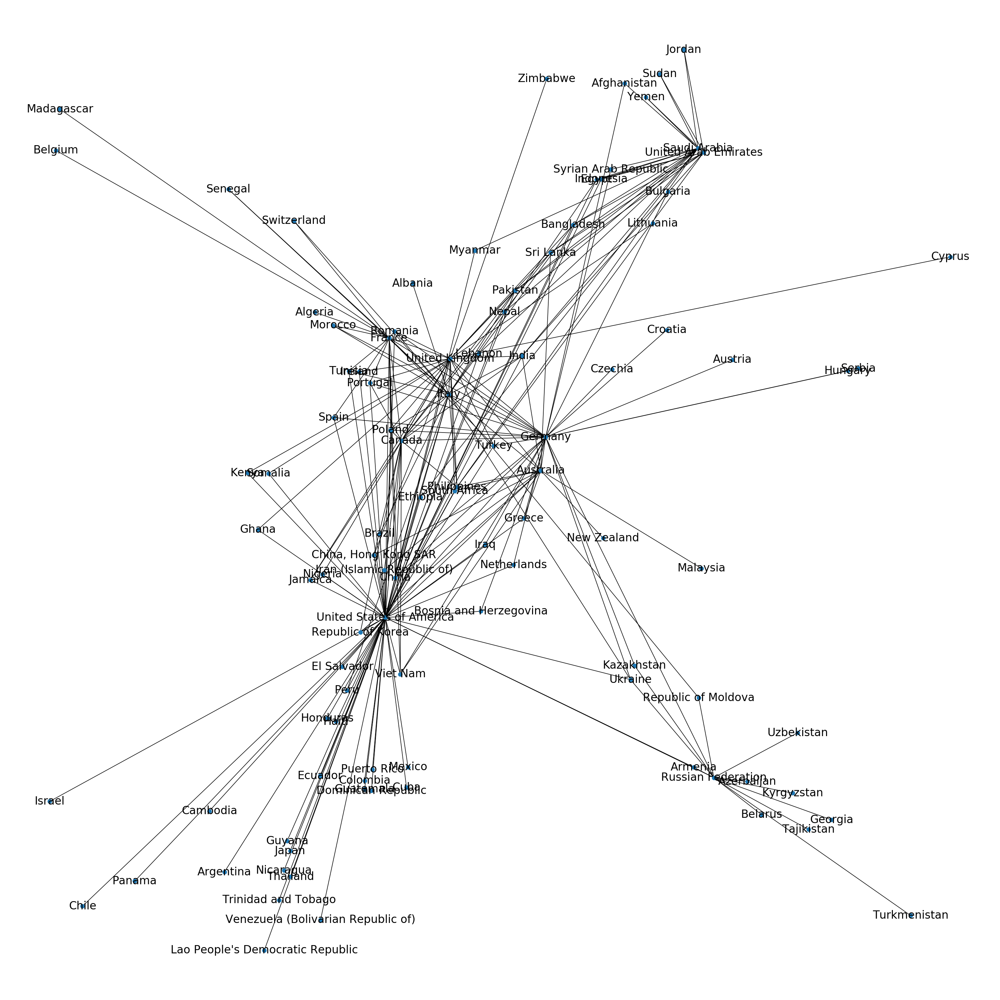

In [132]:
df = df_list[YEAR]

G = nx.Graph() 
for index, row in df.iterrows():
    if index in [int(i) for i in bottom_targets[0]]:
        for col_position in range(len(df.columns)-1):
            # filter out extreme edge weights
            if float(row[col_position+1]) > 100000: # min immigration count is 100,000 persons into that region
                G.add_edge(row[0],list(df.columns)[col_position+1], weight=float(row[col_position+1]), color='black')


from matplotlib.pyplot import figure
figure(num=None, figsize=(25, 25), dpi=120, facecolor='w', edgecolor='k')

pos = nx.spring_layout(G, k=0.15,iterations=50)
# pos = nx.circular_layout(G)
# pos = nx.spring_layout(G, scale=5,k=0.15,iterations=20)   #<<<<<<<<<< Initialize this only once
# nx.draw(G,pos=pos, with_labels=True, node_size = 1000, font_size=10)  #<<<<<<<<< pass the pos variable
# plt.draw() 
# plt.figure() # To plot the next graph in a new figure
# plt.show()

edges = G.edges()
colors = [G[u][v]['color'] for u,v in edges]
weights = [G[u][v]['weight'] for u,v in edges]

nx.draw(G, pos=pos, with_labels=True, node_size = 50, font_size=20, edges=edges, edge_color=colors)

print("filtered graph")

filtered graph


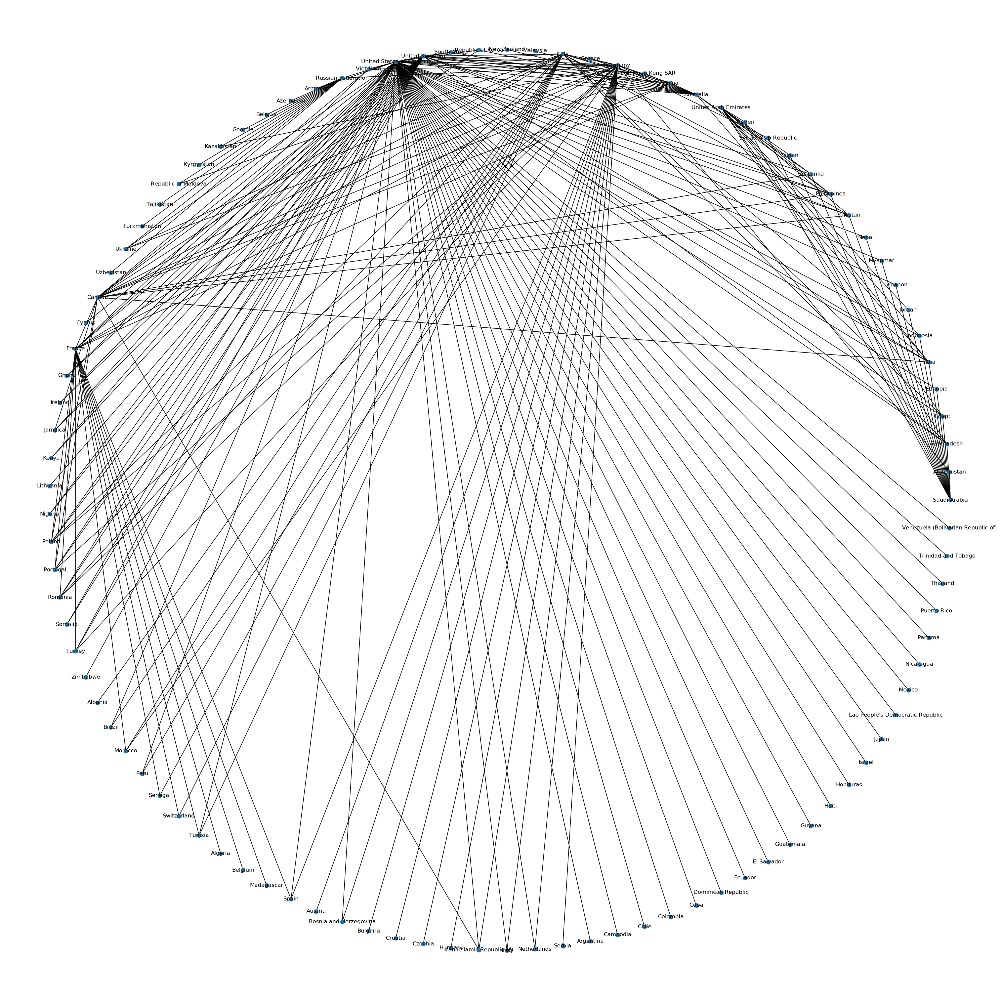

In [135]:
df = df_list[YEAR]

G = nx.Graph() 
for index, row in df.iterrows():
    if index in [int(i) for i in bottom_targets[0]]:
        for col_position in range(len(df.columns)-1):
            # filter out extreme edge weights
            if float(row[col_position+1]) > 100000: # min immigration count is 100,000 persons into that region
                G.add_edge(row[0],list(df.columns)[col_position+1], weight=float(row[col_position+1]), color='black')


from matplotlib.pyplot import figure
figure(num=None, figsize=(25, 25), dpi=120, facecolor='w', edgecolor='k')

# pos = nx.spring_layout(G, k=0.15,iterations=50)
pos = nx.circular_layout(G)
# pos = nx.spring_layout(G, scale=5,k=0.15,iterations=20)   #<<<<<<<<<< Initialize this only once
# nx.draw(G,pos=pos, with_labels=True, node_size = 1000, font_size=10)  #<<<<<<<<< pass the pos variable
# plt.draw() 
# plt.figure() # To plot the next graph in a new figure
# plt.show()

edges = G.edges()
colors = [G[u][v]['color'] for u,v in edges]
weights = [G[u][v]['weight'] for u,v in edges]

nx.draw(G, pos=pos, with_labels=True, node_size = 50, font_size=10, edges=edges, edge_color=colors)

print("filtered graph")

In [147]:
def Graph_Filtered(YEAR, PAX):
        
    df = df_list[YEAR]

    # filtered out - top 1000 best target / destination countries for immigration

    sorted_list=[[],[]]
    for index, row in df.iterrows():
        summ=0
        for col in range(len(df.columns)-1):
            summ+=float(row[col+1])
        sorted_list[0].append(index)
        sorted_list[1].append(summ)
        
    bottom_targets = pd.DataFrame(sorted_list).T.sort_values(by=1).tail(10)
    
    G = nx.Graph() 
    for index, row in df.iterrows():
        if index in [int(i) for i in bottom_targets[0]]:
            for col_position in range(len(df.columns)-1):
                # filter out extreme edge weights
                if float(row[col_position+1]) > PAX: # min immigration count is 100,000 persons into that region
                    G.add_edge(row[0],list(df.columns)[col_position+1], weight=float(row[col_position+1]), color='black')


    from matplotlib.pyplot import figure
    figure(num=None, figsize=(25, 25), dpi=120, facecolor='w', edgecolor='k')

    pos = nx.spring_layout(G, k=0.15,iterations=50)
    # pos = nx.circular_layout(G)
    # pos = nx.spring_layout(G, scale=5,k=0.15,iterations=20)   #<<<<<<<<<< Initialize this only once
    # nx.draw(G,pos=pos, with_labels=True, node_size = 1000, font_size=10)  #<<<<<<<<< pass the pos variable
    # plt.draw() 
    # plt.figure() # To plot the next graph in a new figure
    # plt.show()

    edges = G.edges()
    colors = [G[u][v]['color'] for u,v in edges]
    weights = [G[u][v]['weight'] for u,v in edges]

    nx.draw(G, pos=pos, with_labels=True, node_size = 50, font_size=20, edges=edges, edge_color=colors)

    plt.show()

    df = df_list[YEAR]

    G = nx.Graph() 
    for index, row in df.iterrows():
        if index in [int(i) for i in bottom_targets[0]]:
            for col_position in range(len(df.columns)-1):
                # filter out extreme edge weights
                if float(row[col_position+1]) > PAX: # min immigration count is 100,000 persons into that region
                    G.add_edge(row[0],list(df.columns)[col_position+1], weight=float(row[col_position+1]), color='black')


    from matplotlib.pyplot import figure
    figure(num=None, figsize=(25, 25), dpi=120, facecolor='w', edgecolor='k')

    # pos = nx.spring_layout(G, k=0.15,iterations=50)
    pos = nx.circular_layout(G)
    # pos = nx.spring_layout(G, scale=5,k=0.15,iterations=20)   #<<<<<<<<<< Initialize this only once
    # nx.draw(G,pos=pos, with_labels=True, node_size = 1000, font_size=10)  #<<<<<<<<< pass the pos variable
    # plt.draw() 
    # plt.figure() # To plot the next graph in a new figure
    # plt.show()

    edges = G.edges()
    colors = [G[u][v]['color'] for u,v in edges]
    weights = [G[u][v]['weight'] for u,v in edges]

    nx.draw(G, pos=pos, with_labels=True, node_size = 50, font_size=10, edges=edges, edge_color=colors)

    plt.show()



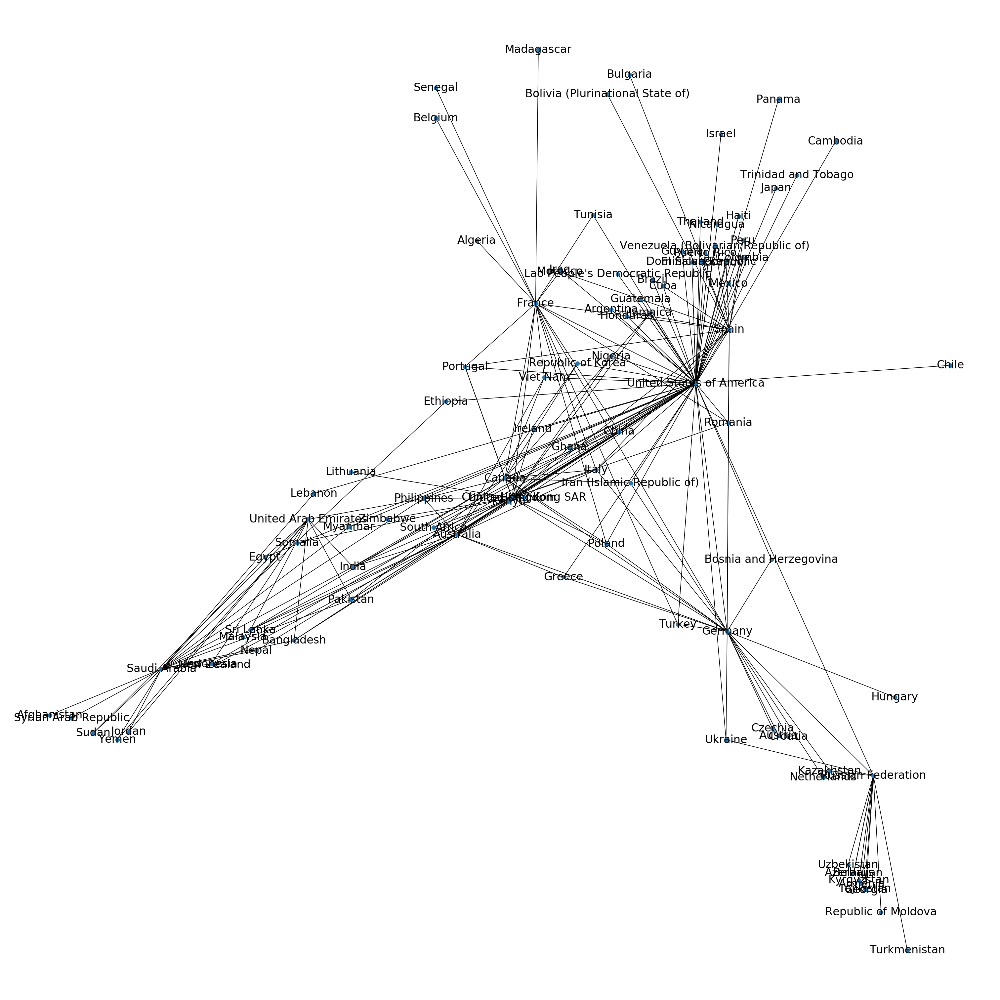

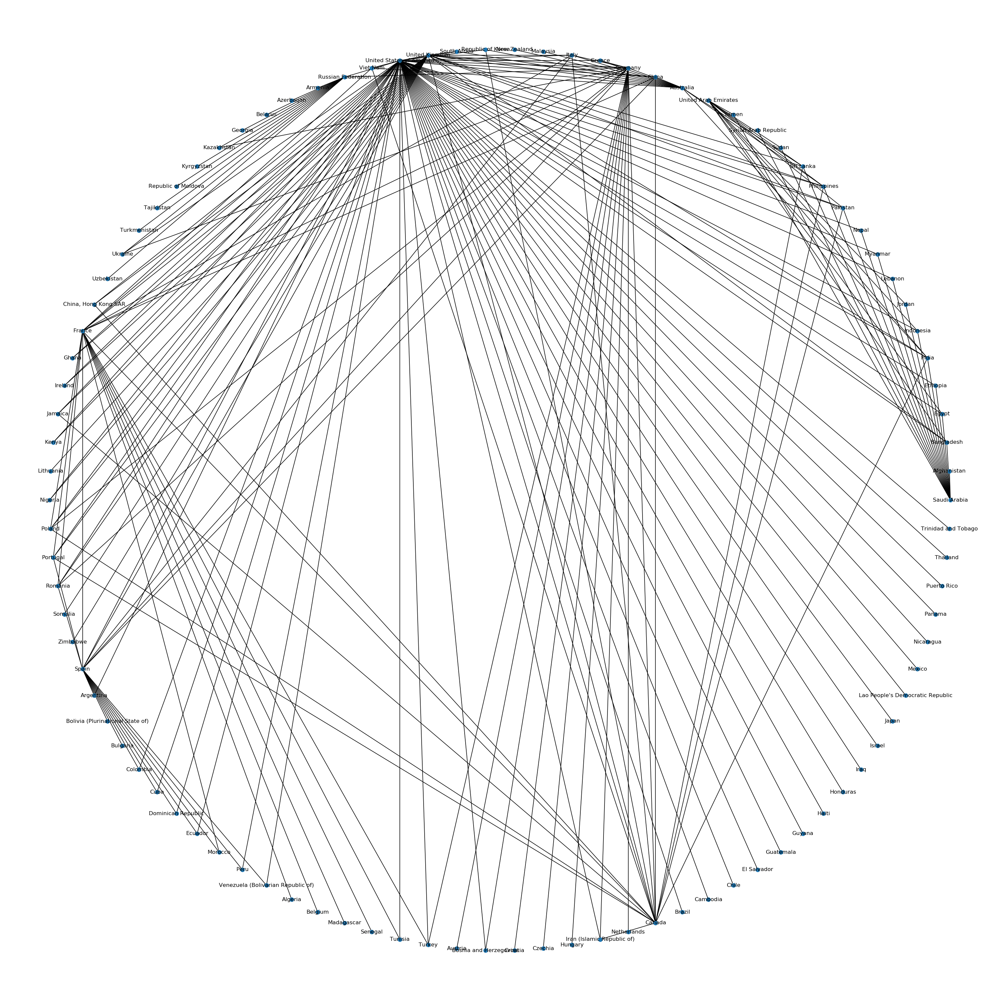

In [149]:
Graph_Filtered(2015, 100000)

In [5]:
# Graph_Filtered(2005, 100000)

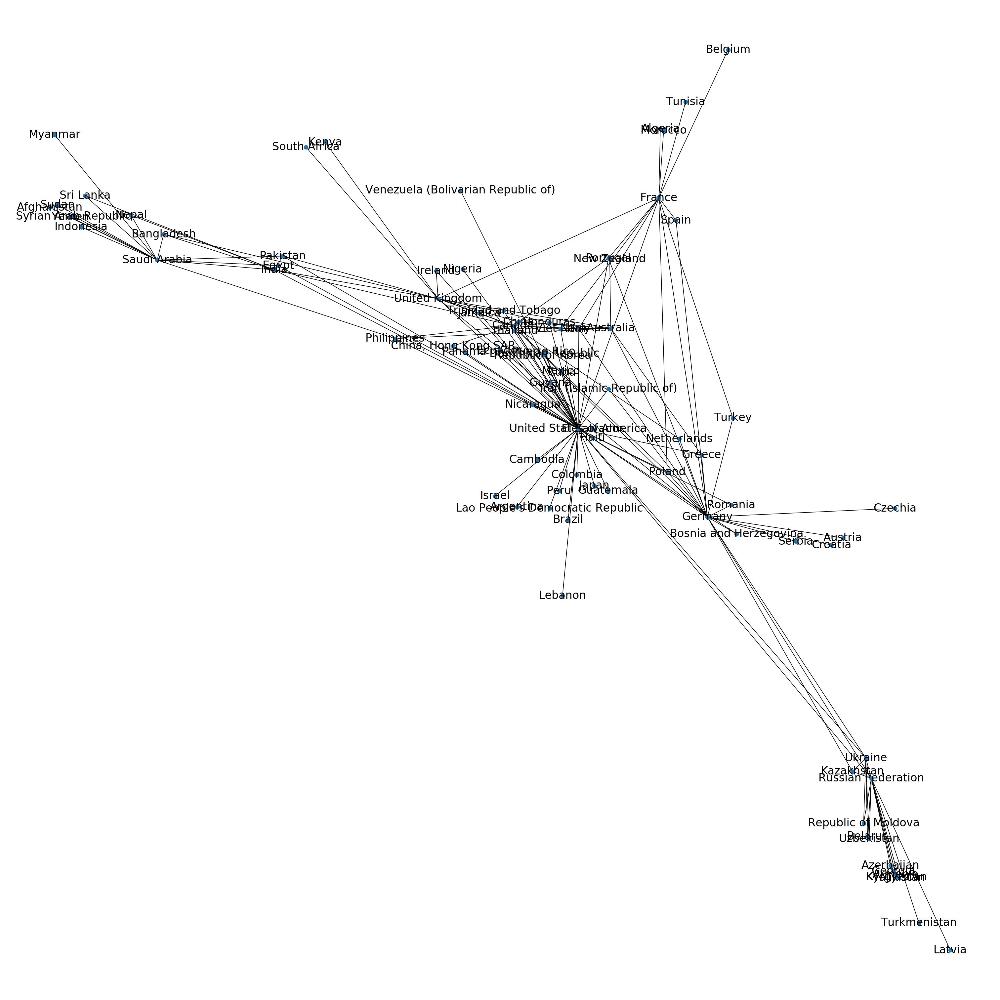

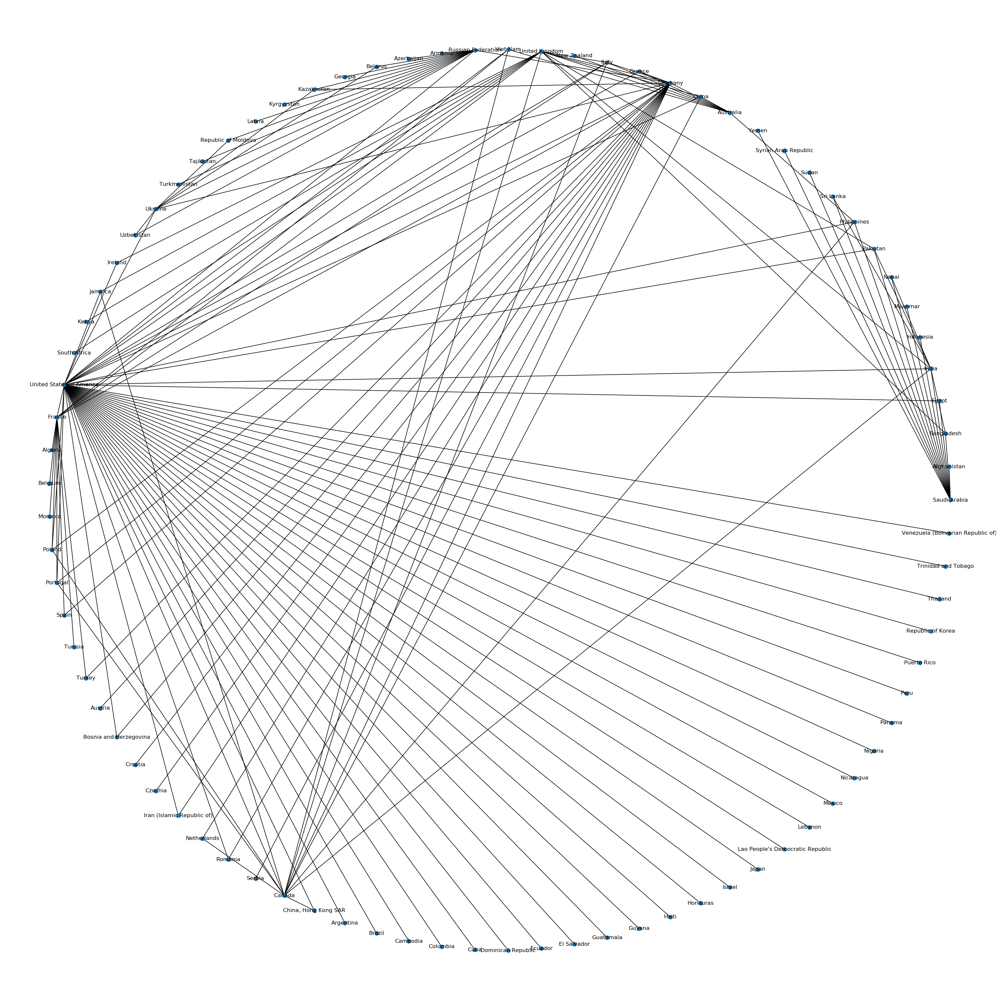

In [156]:
Graph_Filtered(2000, 100000)

In [4]:
# Graph_Filtered(1995, 100000)

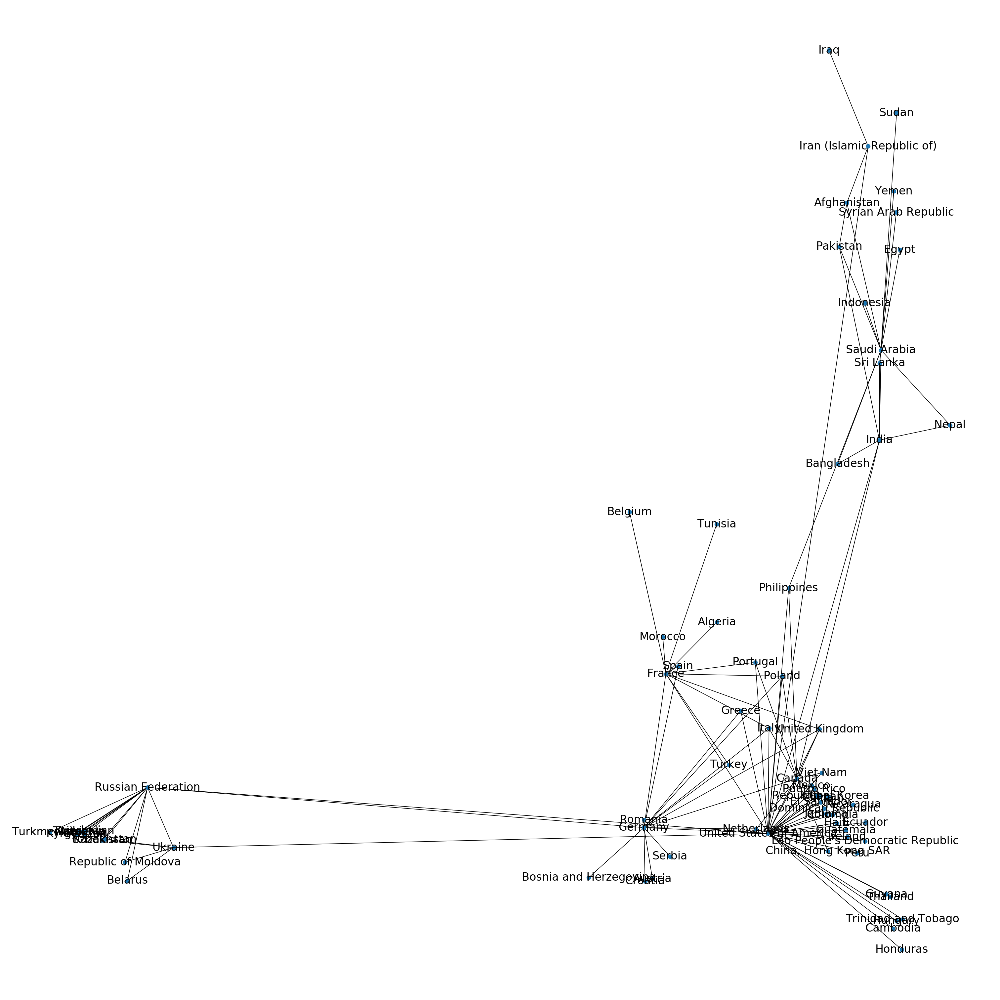

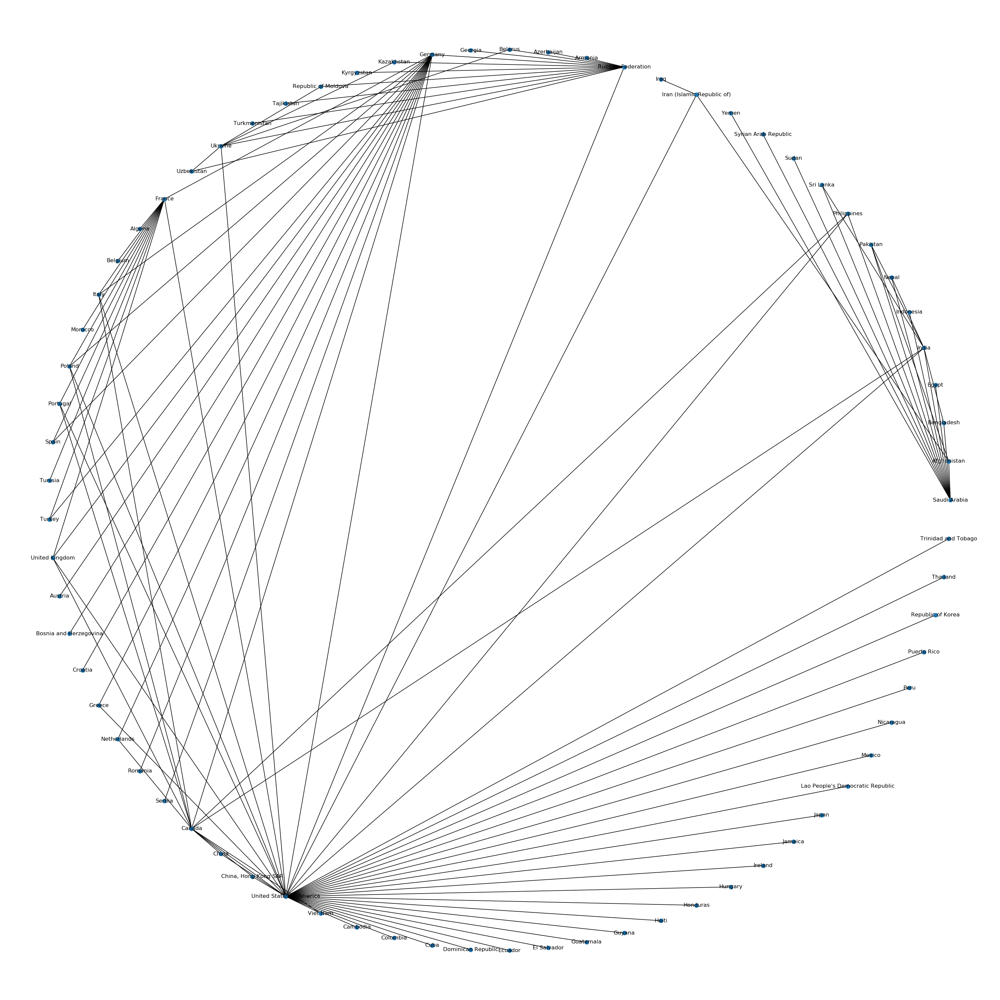

In [158]:
Graph_Filtered(1990, 100000)

# Constant target node

In [8]:
def TargetNode(YEAR = 2019, PAX = 0, target='Hong Kong', source="Bangladesh"):

    df = df_list[YEAR]

    G = nx.Graph() 
    for index, row in df.iterrows():
    #     if index in [int(i) for i in bottom_targets[0]]:
        for col_position in range(len(df.columns)-1):
            # filter out extreme edge weights
            if float(row[col_position+1]) > PAX: # min immigration count is 100,000 persons into that region
                if target in row[0]:
                    print(row[0], ",",list(df.columns)[col_position+1], ",", float(row[col_position+1]))
                    G.add_edge(row[0],list(df.columns)[col_position+1], weight=float(row[col_position+1]), color='black')


    from matplotlib.pyplot import figure
    figure(num=None, figsize=(25, 25), dpi=120, facecolor='w', edgecolor='k')

    color_map = []
    for node in G:
        if target in node:
            color_map.append('red')

        else:
            if source in node:
                color_map.append('green')
            else:
                color_map.append('grey')

    # pos = nx.spring_layout(G, k=0.15,iterations=50)
    pos = nx.circular_layout(G)
    # pos = nx.spring_layout(G, scale=5,k=0.15,iterations=20)   #<<<<<<<<<< Initialize this only once
    # nx.draw(G,pos=pos, with_labels=True, node_size = 1000, font_size=10)  #<<<<<<<<< pass the pos variable
    # plt.draw() 
    # plt.figure() # To plot the next graph in a new figure
    # plt.show()

    edges = G.edges()
    colors = [G[u][v]['color'] for u,v in edges]
    weights = [G[u][v]['weight'] for u,v in edges]

    nx.draw(G, pos=pos, with_labels=True, node_size = 1000, font_size=30, edges=edges, edge_color=colors, node_color = color_map)


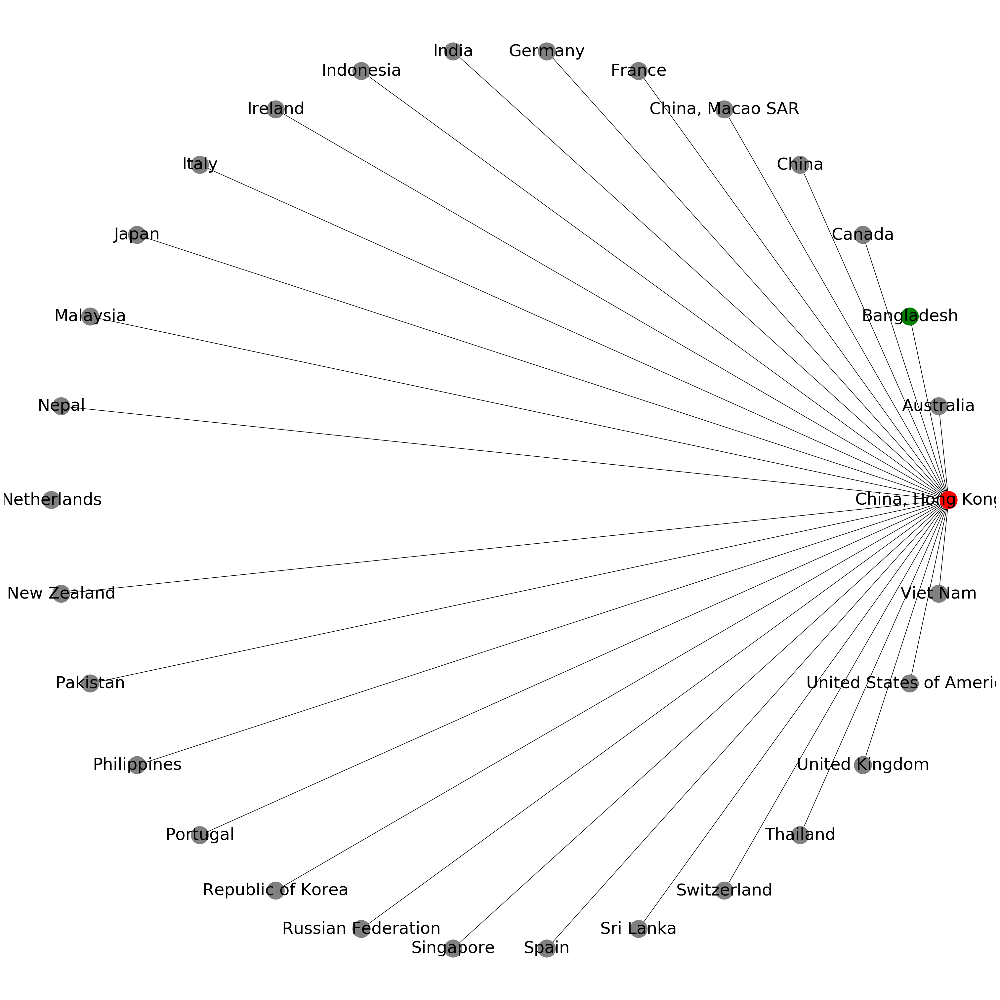

In [281]:
TargetNode(YEAR = 2015, PAX = 0, target='Hong Kong', source="Bangladesh") # apply negative immigration rate to all weights of HK

In [1]:
# TargetNode(YEAR = 2005, PAX = 0, target='Hong Kong', source="Bangladesh") # apply negative immigration rate to all weights of HK

In [35]:
def TargetNodeFlow(YEAR = 2019, YEAR0 = 2015, PAX = 0, target='Hong Kong', source="Bangladesh"):

    df = df_list[YEAR]

    G = nx.Graph(); idx=0
    for index, row in df.iterrows():
    #     if index in [int(i) for i in bottom_targets[0]]:
        for col_position in range(len(df.columns)-1):
            # filter out extreme edge weights
            w = (float(df_list[YEAR].iloc[idx,[col_position+1]])-float(df_list[YEAR0].iloc[idx,[col_position+1]]))
            if w > PAX: # min immigration count is 100,000 persons into that region
                if target in row[0]:
#                     print(index)
#                     print(float(df_list[YEAR].iloc[idx,[col_position+1]]))
#                     print(row[0], ",",list(df.columns)[col_position+1], ",", float(df_list[YEAR].iloc[idx,[col_position+1]])-float(df_list[YEAR-5].iloc[idx,[col_position+1]]))
                    G.add_edge(row[0],list(df.columns)[col_position+1], weight=w, color='black')
        idx+=1


    from matplotlib.pyplot import figure
    figure(num=None, figsize=(25, 25), dpi=120, facecolor='w', edgecolor='k')

    color_map = []
    for node in G:
        if target in node:
            color_map.append('red')

        else:
            if source in node:
                color_map.append('green')
            else:
                color_map.append('grey')

    pos = nx.spring_layout(G, k=0.9,iterations=50)
#     pos = nx.shell_layout(G)
#     pos = nx.kamada_kawai_layout(G)
    # pos = nx.spring_layout(G, scale=5,k=0.15,iterations=20)   #<<<<<<<<<< Initialize this only once
    # nx.draw(G,pos=pos, with_labels=True, node_size = 1000, font_size=10)  #<<<<<<<<< pass the pos variable
    # plt.draw() 
    # plt.figure() # To plot the next graph in a new figure
    # plt.show()

    edges = G.edges()
    colors = [G[u][v]['color'] for u,v in edges]
    weights = [G[u][v]['weight'] for u,v in edges]

    nx.draw(G, pos=pos, with_labels=True, node_size = 1000, font_size=10, edges=edges, edge_color=colors, node_color = color_map)

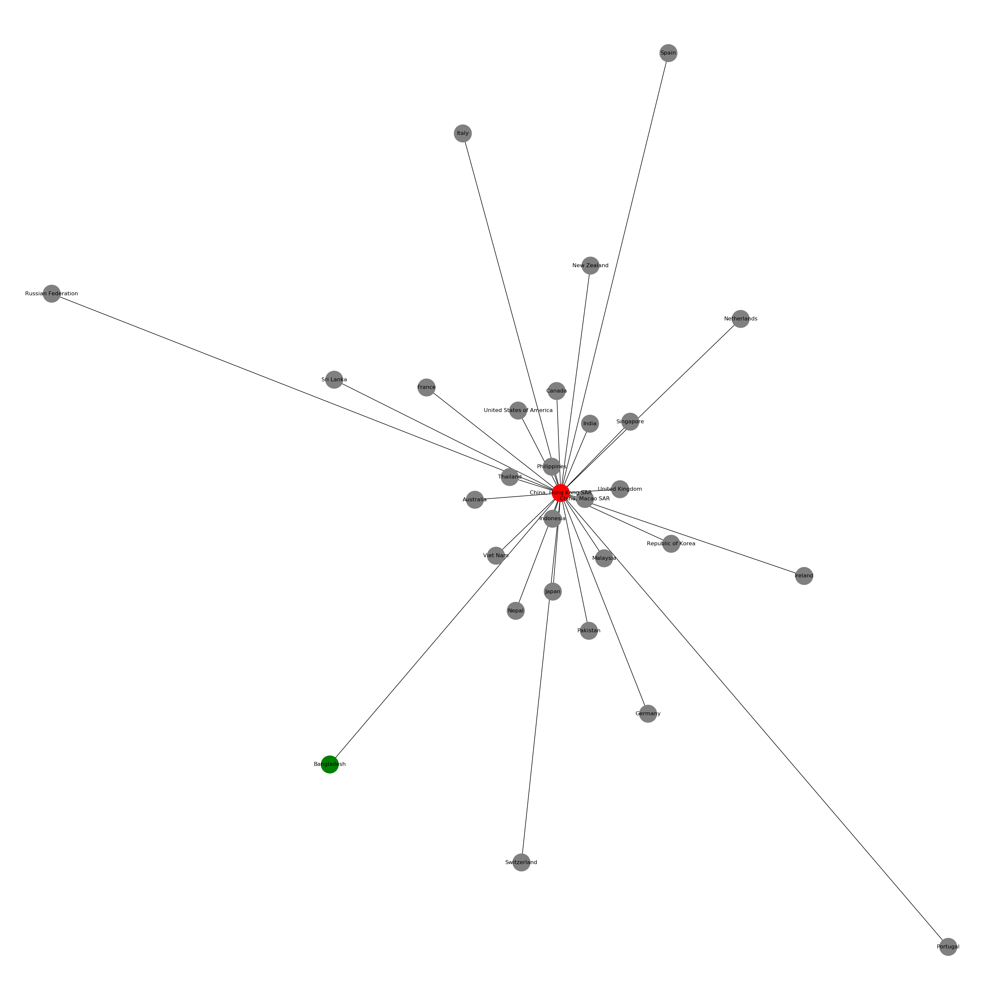

In [36]:
TargetNodeFlow(YEAR = 2019, YEAR0 = 2015, PAX = 0, target='Hong Kong', source="Bangladesh") # apply negative immigration rate to all weights of HK

In [58]:
def SourceNodeFlow(YEAR = 2019, YEAR0 = 2015, PAX = 0, target='Hong Kong', source="Bangladesh"):

    df = df_list[YEAR]

    G = nx.Graph(); idx=0
    for index, row in df.iterrows():
        for col_position in range(len(df.columns)-1):
            # filter out extreme edge weights
            w = (float(df_list[YEAR].iloc[idx,[col_position+1]])-float(df_list[YEAR0].iloc[idx,[col_position+1]]))
            if w > PAX: # min immigration count is 100,000 persons into that region
                if source in list(df.columns)[col_position+1]:
                    G.add_edge(row[0],list(df.columns)[col_position+1], weight=w, color='black')
        idx+=1


    from matplotlib.pyplot import figure
    figure(num=None, figsize=(25, 25), dpi=120, facecolor='w', edgecolor='k')

    color_map = []
    for node in G:
        if target in node:
            color_map.append('red')

        else:
            if source in node:
                color_map.append('green')
            else:
                color_map.append('grey')

#     pos = nx.spring_layout(G, k=0.9,iterations=50)
    pos = nx.shell_layout(G)
#     pos = nx.kamada_kawai_layout(G)
    # pos = nx.spring_layout(G, scale=5,k=0.15,iterations=20)   #<<<<<<<<<< Initialize this only once
    # nx.draw(G,pos=pos, with_labels=True, node_size = 1000, font_size=10)  #<<<<<<<<< pass the pos variable
    # plt.draw() 
    # plt.figure() # To plot the next graph in a new figure
    # plt.show()

    edges = G.edges()
    colors = [G[u][v]['color'] for u,v in edges]
    weights = [G[u][v]['weight'] for u,v in edges]

    nx.draw(G, pos=pos, with_labels=True, node_size = 1000, font_size=10, edges=edges, edge_color=colors, node_color = color_map)

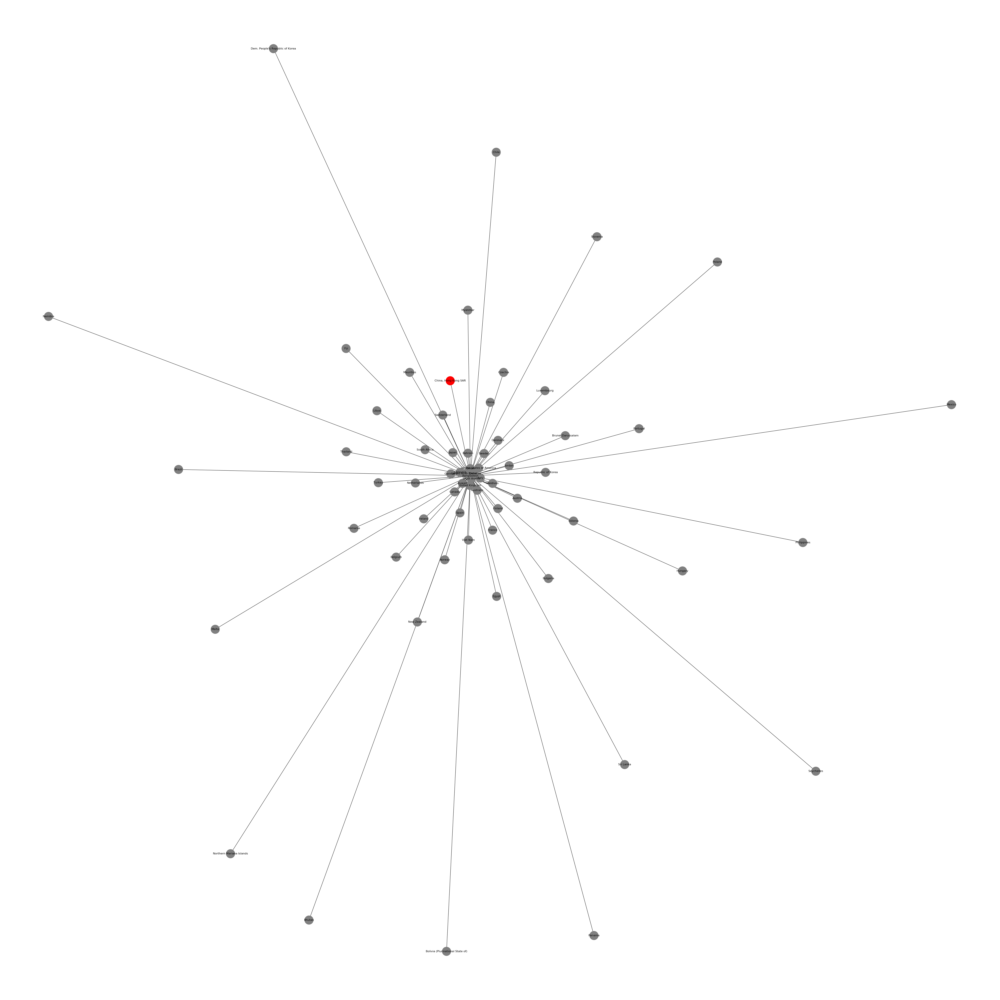

In [52]:
SourceNodeFlow(YEAR = 2019, YEAR0 = 2015, PAX = 0, target='Hong Kong', source="Bangladesh") # apply negative immigration rate to all weights of HK

In [2]:
# SourceNodeFlow(YEAR = 2015, YEAR0 = 2010, PAX = 0, target='Hong Kong', source="Bangladesh") # apply negative immigration rate to all weights of HK

In [3]:
# SourceNodeFlow(YEAR = 2019, YEAR0 = 2015, PAX = 0, target='Hong Kong', source="Hong Kong") # apply negative immigration rate to all weights of HK

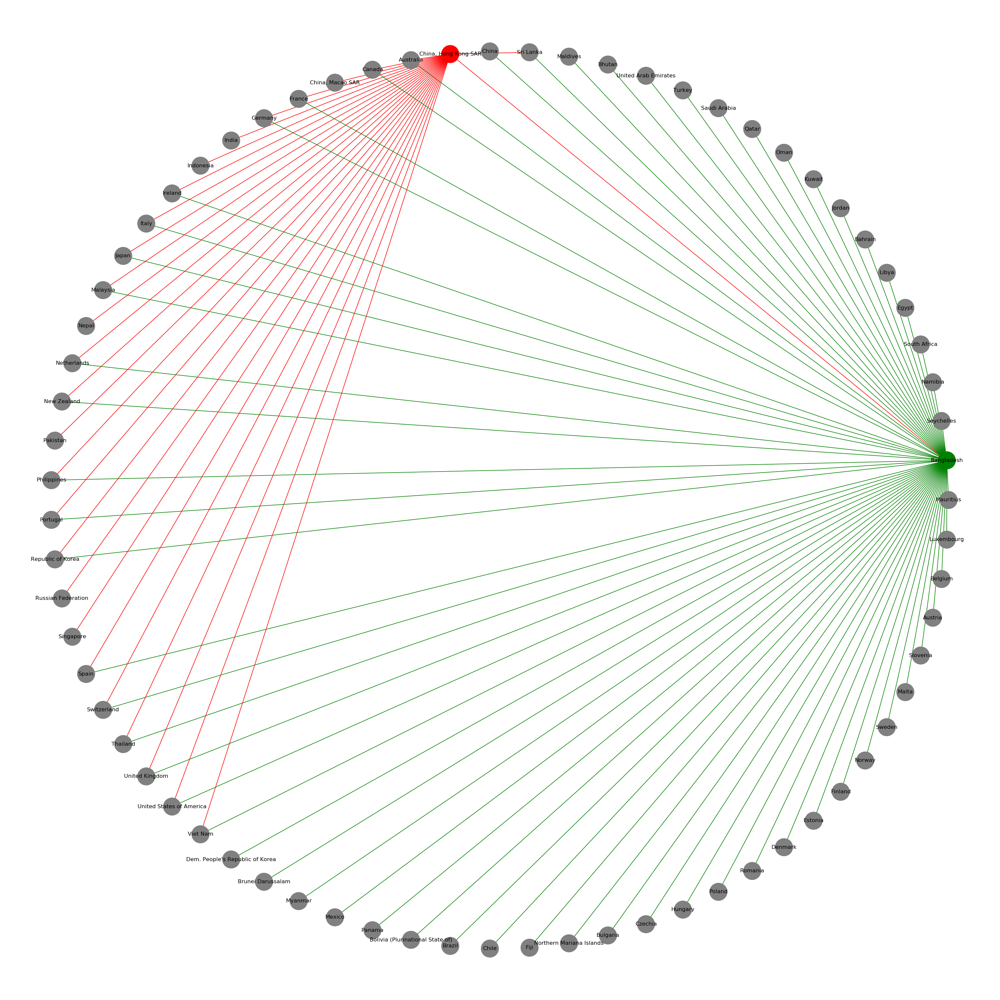

In [61]:
YEAR = 2019; YEAR0 = 2015; PAX = 0; target='Hong Kong'; source="Bangladesh"

df = df_list[YEAR]

G = nx.Graph(); idx=0
for index, row in df.iterrows():
    for col_position in range(len(df.columns)-1):
        w = (float(df_list[YEAR].iloc[idx,[col_position+1]])-float(df_list[YEAR0].iloc[idx,[col_position+1]]))
        if w > PAX:
            if source in list(df.columns)[col_position+1]:
                G.add_edge(row[0],list(df.columns)[col_position+1], weight=w, color='green')
            if target in row[0]:
                G.add_edge(row[0],list(df.columns)[col_position+1], weight=w, color='red')
    idx+=1


from matplotlib.pyplot import figure
figure(num=None, figsize=(25, 25), dpi=120, facecolor='w', edgecolor='k')

color_map = []
for node in G:
    if target in node:
        color_map.append('red')

    else:
        if source in node:
            color_map.append('green')
        else:
            color_map.append('grey')

# pos = nx.spring_layout(G, k=0.9,iterations=50)
pos = nx.shell_layout(G)

edges = G.edges()
colors = [G[u][v]['color'] for u,v in edges]
weights = [G[u][v]['weight'] for u,v in edges]

nx.draw(G, pos=pos, with_labels=True, node_size = 1000, font_size=10, edges=edges, edge_color=colors, node_color = color_map)